# Predicting Customer Segment

In [82]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import GridSearchCV, train_test_split, KFold, cross_val_score
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score,f1_score

from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist

### Loading and Pre-processing

In [2]:
def get_cost(cost):
    return cost[:-1]

In [70]:
orders_rf1 = pd.read_csv('orders_rf.csv')
orders_rf1.head()

,Unnamed: 0,user_id,count,sum,mean,median
0,0,1,10,190.0,19.000000,19.5
1,1,2,14,228.0,16.285714,13.0
2,2,3,12,144.0,12.000000,11.0
3,3,4,5,85.0,17.000000,19.0
4,4,5,4,46.0,11.500000,10.5


In [4]:
orders_rf = pd.read_csv('orders_rf.csv')
orders_rf = orders_rf[orders_rf.columns[1:]]
orders_rf.columns = ['user_id','frequency','recency_sum','recency_mean','recency_median' ]
orders_rf.shape

(206209, 5)

In [5]:
# orders_merged.head()

In [6]:
orders_merged = pd.read_csv('orders_merged.csv')
orders_merged.shape

print(orders_merged.shape)
orders_merged.dropna(inplace=True)
print(orders_merged.shape)

orders_merged['Average cost'] = orders_merged['Average cost'].map(get_cost)

(32434489, 12)
(32365344, 12)


In [7]:
freq = orders_merged.groupby(['user_id'])['order_id'].count().reset_index()
freq.columns = list(freq.columns)[:-1]+['frequency']
freq.head()

,user_id,frequency
0,1,59
1,2,195
2,3,88
3,4,18
4,5,37


In [8]:
orders_merged['Average cost'] = orders_merged['Average cost'].astype('float32')

In [9]:
# pd.isnull(orders_merged).sum()

In [10]:
# for a in pd.unique(orders_merged['Average cost']):
#     print(a, get_cost(a))

In [11]:
orders_merged_revenue = orders_merged.groupby('user_id')['Average cost'].agg(['sum', 'mean']).reset_index()
orders_merged_revenue.columns = ['user_id', 'total_revenue', 'mean_revenue']

In [12]:
orders_merged_revenue.head()

,user_id,total_revenue,mean_revenue
0,1,346.000000,5.864407
1,2,1195.699951,6.131795
2,3,619.599976,7.040909
3,4,162.800003,9.044444
4,5,276.200012,7.464865


In [13]:
orders_rf.head()

,user_id,frequency,recency_sum,recency_mean,recency_median
0,1,10,190.0,19.000000,19.5
1,2,14,228.0,16.285714,13.0
2,3,12,144.0,12.000000,11.0
3,4,5,85.0,17.000000,19.0
4,5,4,46.0,11.500000,10.5


In [14]:
rfm = orders_rf.merge(orders_merged_revenue, on = 'user_id')
rfm = rfm[['user_id','recency_mean', 'total_revenue']]
rfm = rfm.merge(freq, on='user_id')
rfm.shape

(206209, 4)

### Calculate the RFM scores:

In [15]:
# rfm.frequency.hist()
import plotly.express as px
fig = px.histogram(rfm[rfm.frequency<700], x="frequency",title='Frequency' ,
                   color_discrete_sequenc`e=['blue'], nbins=300
#                    color_discrete_map = color_dict
                  )
fig.update_layout(bargap=0.2)
# fig.)
fig.show()

In [16]:
# rfm.recency_mean.hist()

fig = px.histogram(rfm, x="recency_mean",title='Recency' ,
                   color_discrete_sequence=['blue'], nbins=70
#                    color_discrete_map = color_dict
                  )
fig.update_layout(bargap=0.2)
# fig.)
fig.show()

In [17]:
# rfm.total_revenue.hist()
# [rfm.recency_mean<700]
fig = px.histogram(rfm[rfm.total_revenue<15000], x="total_revenue",title='Revenue (by Department)' ,
                   color_discrete_sequence=['blue'], nbins=150
#                    color_discrete_map = color_dict
                  )
fig.update_layout(bargap=0.2)
# fig.)
fig.show()

In [18]:
total_revenue_cut5 = list(pd.unique(pd.qcut(rfm.total_revenue,[0,.2,.4,.6,.8,1])))
total_revenue_cut5

[Interval(239.0, 453.4, closed='right'),
 Interval(825.8, 1692.1, closed='right'),
 Interval(453.4, 825.8, closed='right'),
 Interval(8.999, 239.0, closed='right'),
 Interval(1692.1, 24674.9, closed='right')]

In [19]:
def map_total_revenue_cut5(x, total_revenue_cut5):
    for i in range(len(total_revenue_cut5)):
         if x in total_revenue_cut5[i]:
#                 print(total_revenue_cut5[i])
                return i+1
    if x<9:
        return 1
    return 5

In [20]:
rfm['total_revenue_score'] =\
    rfm.total_revenue.map(lambda x: map_total_revenue_cut5(x, total_revenue_cut5=sorted(total_revenue_cut5)))

In [21]:
rfm['total_revenue_score'].value_counts()

1    41263
4    41244
3    41243
5    41237
2    41222
Name: total_revenue_score, dtype: int64

In [22]:
total_recency_mean_cut5 = sorted(list(pd.unique(pd.qcut(rfm.recency_mean,[0,.2,.4,.6,.8,1]))))
total_recency_mean_cut5

[Interval(-0.001, 8.764, closed='right'),
 Interval(8.764, 12.92, closed='right'),
 Interval(12.92, 17.067, closed='right'),
 Interval(17.067, 22.0, closed='right'),
 Interval(22.0, 30.0, closed='right')]

In [23]:
def map_recency_mean_cut5(x, cutlist):
    for i in range(len(cutlist)):
         if x in cutlist[i]:
                return i+1
    if x<0:
        return 1
    return 5

In [24]:
rfm['recency_score'] =\
    rfm.recency_mean.map(lambda x: map_recency_mean_cut5(x, total_recency_mean_cut5))

In [25]:
rfm['recency_score'].value_counts()

4    42344
3    41255
2    41254
1    41242
5    40114
Name: recency_score, dtype: int64

In [26]:
total_frequency_cut5 = sorted(list(pd.unique(pd.qcut(rfm.frequency,[0,.2,.4,.6,.8,1]))))
total_frequency_cut5

[Interval(1.999, 32.0, closed='right'),
 Interval(32.0, 62.0, closed='right'),
 Interval(62.0, 112.0, closed='right'),
 Interval(112.0, 230.0, closed='right'),
 Interval(230.0, 3723.0, closed='right')]

In [27]:
def map_frequency_cut5(x, cutlist):
    for i in range(len(cutlist)):
         if x in cutlist[i]:
                return i+1
    if x<2:
        return 1
    return 5

In [28]:
rfm['frequency_score'] =\
    rfm.frequency.map(lambda x: map_frequency_cut5(x, total_frequency_cut5))
rfm['frequency_score'].value_counts()

2    42104
4    41315
1    41274
5    41165
3    40351
Name: frequency_score, dtype: int64

In [29]:
rfm['rfm_score'] = rfm['frequency_score']*rfm['recency_score']*rfm['total_revenue_score']

In [30]:
rfm['rfm_score'].agg(['min', 'max', 'mean', 'median'])

min         1.000000
max       125.000000
mean       26.519027
median     24.000000
Name: rfm_score, dtype: float64

In [31]:
rfm_cut5 = sorted(pd.unique(pd.cut(rfm['rfm_score'], 5)))
rfm_cut5

[Interval(0.876, 25.8, closed='right'),
 Interval(25.8, 50.6, closed='right'),
 Interval(50.6, 75.4, closed='right'),
 Interval(75.4, 100.2, closed='right'),
 Interval(100.2, 125.0, closed='right')]

In [32]:
def map_rfm_score_cut5(x, cutlist):
    for i in range(len(cutlist)):
         if x in cutlist[i]:
                return i+1

    return 5

In [171]:
rfm['segment']=\
    rfm.rfm_score.map(lambda x: map_rfm_score_cut5(x, rfm_cut5))
rfm['segment'].value_counts(normalize=True)*100

1    61.073474
2    29.517140
3     6.846937
4     2.436848
5     0.125601
Name: segment, dtype: float64

In [34]:
X = rfm[['frequency', 'recency_mean', 'total_revenue']]
y = rfm[['segment']]

In [35]:
strategy = {1:125939, 2:int(60867*1.5), 3:int(32349*2), 4:25000, 5:25000}
oversample = SMOTE(sampling_strategy=strategy)
X, y = oversample.fit_resample(X, y)

In [36]:
y.value_counts(normalize=True)*100

segment
1          37.940633
2          27.505219
3          19.491048
4           7.531550
5           7.531550
dtype: float64

### Modelling

In [38]:
def print_cls_metrics(y_pred, y_test):
    print('--Model evaluation metrics--')
    print('Accuracy:')
    print(f'{round(accuracy_score(y_pred, y_test), 4)*100}%')
    print()
    print('Confusion matrix:')
    print(confusion_matrix(y_pred, y_test))
    print()
    print('Classification report:')
    print(classification_report(y_pred, y_test))
    print()
#     print('ROC-AUC:')
#     print(f'{round(roc_auc_score(y_pred, y_test, multi_class = "ovr"), 4)*100}%')

In [39]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

* Logistic Regression

In [174]:
logreg = LogisticRegression(random_state=0, penalty='elasticnet', solver='saga', l1_ratio=0.5)
logreg.fit(X_train, y_train)
y_pred_lr = logreg.predict(X_test)

print(f"F1-score: {f1_score(y_test,y_pred_lr,average='micro')}")

# evaluate predictions
print_cls_metrics(y_test, y_pred_lr)

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:985: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



F1-score: 0.3361551284368661
--Model evaluation metrics--
Accuracy:
33.62%

Confusion matrix:
[[31000  2304  4437     0    11]
 [24103  2348   923     0     3]
 [18382   856   127     0     0]
 [ 7486    51     0     0     0]
 [ 7551     0     0     0     0]]

Classification report:
              precision    recall  f1-score   support

           1       0.35      0.82      0.49     37752
           2       0.42      0.09      0.14     27377
           3       0.02      0.01      0.01     19365
           4       0.00      0.00      0.00      7537
           5       0.00      0.00      0.00      7551

    accuracy                           0.34     99582
   macro avg       0.16      0.18      0.13     99582
weighted avg       0.25      0.34      0.23     99582




/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control

* Random Forest 

In [173]:
clf = RandomForestClassifier(max_depth=5, random_state=0)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print(f"F1-score: {f1_score(y_test,y_pred,average='micro')}")

# evaluate predictions
print_cls_metrics(y_test, y_pred)

<ipython-input-173-d80c17f77fb2>:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



F1-score: 0.9439959028740135
--Model evaluation metrics--
Accuracy:
94.39999999999999%

Confusion matrix:
[[37281   471     0     0     0]
 [    3 27371     3     0     0]
 [    0  1419 17941     5     0]
 [    0     0  3513  3861   163]
 [    0     0     0     0  7551]]

Classification report:
              precision    recall  f1-score   support

           1       1.00      0.99      0.99     37752
           2       0.94      1.00      0.97     27377
           3       0.84      0.93      0.88     19365
           4       1.00      0.51      0.68      7537
           5       0.98      1.00      0.99      7551

    accuracy                           0.94     99582
   macro avg       0.95      0.89      0.90     99582
weighted avg       0.95      0.94      0.94     99582




* XGBoost

In [79]:
xgb = XGBClassifier(booster='gbtree', learning_rate=0.01, max_depth=5)
xgb.fit(X_train, y_train)

# predict
y_pred_xg = xgb.predict(X_test)

print(f"F1-score: {f1_score(y_test,y_pred_xg,average='micro')}")

print_cls_metrics(y_test, y_pred_xg)

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/Users/aniket1899/opt/anaconda3/lib/python3.8/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



[00:22:45] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
F1-score: 0.961830451286377
--Model evaluation metrics--
Accuracy:
96.17999999999999%

Confusion matrix:
[[37752     0     0     0     0]
 [    6 27112   259     0     0]
 [    0    18 19341     6     0]
 [    0     0  3509  4025     3]
 [    0     0     0     0  7551]]

Classification report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00     37752
           2       1.00      0.99      0.99     27377
           3       0.84      1.00      0.91     19365
           4       1.00      0.53      0.70      7537
           5       1.00      1.00      1.00      7551

    accuracy                           0.96     99582
   macro avg       0.97      0.90      0

---
# Performing clustering analysis on the customer segments 1-5
### Procedure:
* Subset for a Customer Segment.
* Detect the optimal number of clusters for the segment.
* Analyze the clusters.


In [91]:
def elbow(r_seg, segment):
    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    K = range(1, 10)

    for k in K:
        # Building and fitting the model
        kmeanModel = KMeans(n_clusters=k)
        kmeanModel.fit(r_seg)

        distortions.append(sum(np.min(cdist(r_seg, kmeanModel.cluster_centers_,
                                            'euclidean'), axis=1)) / r_seg.shape[0])
        inertias.append(kmeanModel.inertia_)

        mapping1[k] = sum(np.min(cdist(r_seg, kmeanModel.cluster_centers_,
                                       'euclidean'), axis=1)) / r_seg.shape[0]
        mapping2[k] = kmeanModel.inertia_
    plt.plot(K, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title(f'The Distortion Elbow Curve for Segment {segment}')
    plt.show()

### For customer Segment = 1

In [165]:
r1 = rfm[rfm.segment==1][['recency_mean', 'total_revenue', 'frequency']]

fig = px.scatter(r1,x='recency_mean', y='frequency', color='total_revenue')
fig.show()

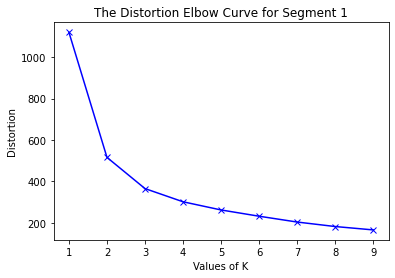

In [101]:
elbow(r1, '1')

#### Optimal no of clusters: 6
---


### For customer Segment = 2

In [176]:
r2 = rfm[rfm.segment==2][['recency_mean', 'total_revenue', 'frequency']]

fig = px.scatter(r2,x='recency_mean', y='frequency', color='total_revenue', title='Customer Segment #2')
fig.show()

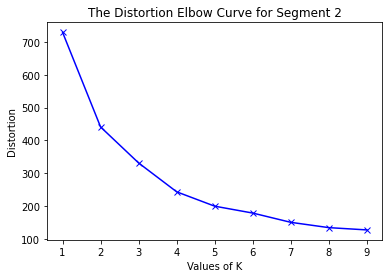

In [139]:
elbow(r2, '2')

#### Optimal no of clusters: 5
---

### For customer Segment = 3

In [177]:
r3 = rfm[rfm.segment==3]

fig = px.scatter(r3,x='recency_mean', y='frequency', color='total_revenue', title='Customer Segment #3')
fig.show()

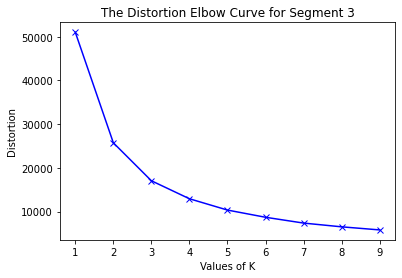

In [104]:
elbow(r3, '3')

#### Optimal no of clusters: 3
---


### For customer Segment = 4

In [166]:
r4 = rfm[rfm.segment==4]

fig = px.scatter(r4,x='recency_mean', y='frequency', color='total_revenue')
fig.show()

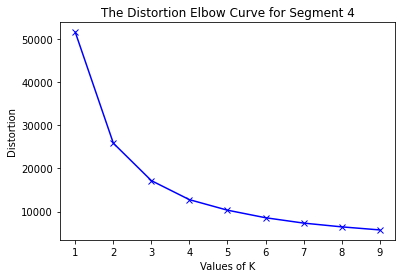

In [105]:
elbow(r4, '4')

#### Optimal no of clusters: 2
---


### For customer Segment = 5

In [54]:
r5 = rfm[rfm.segment==5]

fig = px.scatter(r5,x='recency_mean', y='frequency', color='total_revenue')
fig.show()

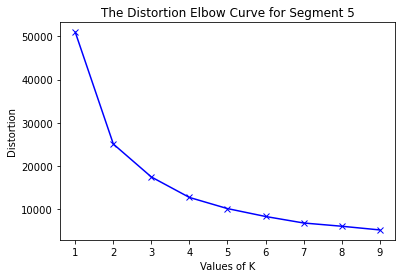

In [107]:
elbow(r5, '5')

#### Optimal no of clusters: 2 
#### But it's hard to visualize the clusters in the above plot
---


### Analyzing the clusters for Segment = 2
* Clusters=5

In [152]:
kmeans2 = KMeans(n_clusters=5, random_state=0).fit(r2)
kmeans_pred2 = kmeans2.predict(r2)
r2_copy = r2.copy()
r2_copy['kcluster'] = kmeans_pred2
r2_copy['kcluster'] = r2_copy['kcluster'].astype('str')

In [168]:
fig = px.scatter(r2_copy,x='recency_mean', y='frequency', color='kcluster', title="Clusters for Segment #2")
fig.show()

In [160]:
r2_cluster_group = r2_copy.groupby(['kcluster'])[['recency_mean', 'frequency', 'total_revenue']].agg(['mean'])
r2_cluster_group

,recency_mean,frequency,total_revenue
,mean,mean,mean
kcluster,,,
0,18.660012,93.495571,674.617065
1,10.429604,509.333435,3838.621582
2,12.642400,183.695115,1354.412842
3,10.158270,789.256563,6315.746094
4,10.694851,323.211556,2392.406494


### Observations:
* In the above table, we can see that there are different attributes of the three values (frequency, recency, revenue)
* For example, cluster #3 has low average recency, but high frequency and revenue
* another example is clsuter #0 which has high recency but low frequency and total revenue.
* We can also see these clusters in the clustering plot above.
* We can further analyse the purchasing behaviours of the customers belonging to these clusters from the same segment. Then come up with targeted strategies for these segment of customers.

In [164]:
# r2_cluster_group.to_csv('r2_cluster_group.csv')